# Test gait_evaluate.py

In [1]:
import os


if "original_dir" in globals():
    # current_dir = os.path.dirname(original_dir)
    current_dir = original_dir
    os.chdir(current_dir)
    print(f"Current directory: {current_dir}")
else:
    original_dir = os.getcwd()
    print(f"Current directory: {original_dir}")

os.chdir("../../../../")
print(f"Changed directory: {os.getcwd()}")


Current directory: d:\northeastern\neu_dev\myo_assist_dev\myosuite\rl_train\myoassist\analyzer
Changed directory: d:\northeastern\neu_dev\myo_assist_dev


In [2]:
import os
from myosuite.rl_train.myoassist.utils.handlers.train_log_handler import TrainLogHandler
from myosuite.rl_train.myoassist.utils.handlers.train_checkpoint_data_imitation import ImitationTrainCheckpointData
log_folder_name = input("folder_name")
if log_folder_name == "":
    log_folder_name = "train_session_20250304-035313_dephy"
log_dir = os.path.join("train_logs","selected",log_folder_name)
analyze_result_dir = os.path.join(log_dir,"analyze_results")
if not os.path.exists(analyze_result_dir):
    os.makedirs(analyze_result_dir)

log_handler = TrainLogHandler(log_dir,"session_name")
log_handler.load_log_data(ImitationTrainCheckpointData)


MyoSuite:> Registering Myo Envs


In [3]:
from myosuite.rl_train.myoassist.utils.data_types import DictionableDataclass
DictionableDataclass.to_dict(log_handler.log_datas[-1])

{'approx_kl': 0.015508958138525486,
 'clip_fraction': 0.14595947265625,
 'clip_range': 0.2,
 'clip_range_vf': 100.0,
 'entropy_loss': -20.172224044799805,
 'explained_variance': 0.1691833734512329,
 'learning_rate': 0.0002,
 'loss': -0.03411174193024635,
 'n_updates': 23586,
 'policy_gradient_loss': -0.008056383981602267,
 'std': 0.5429683327674866,
 'value_loss': 0.0008599176013376564,
 'num_timesteps': 10002432,
 'average_num_timestep': 141.77777777777777,
 'average_reward_per_episode': 14.006517909883907,
 'time': '20250304-044707.552992',
 'reward_accumulate': {'forward_reward': 256.2506311944701,
  'muscle_activation_penalize': 138.1239791631836,
  'muscle_activation_diff_penalize': 241.01600078109084,
  'joint_imitation_reward_pelvis_ty': 269.32275415590357,
  'joint_imitation_reward_pelvis_tilt': 268.230244691838,
  'joint_imitation_reward_hip_flexion_l': 252.06702829551375,
  'joint_imitation_reward_hip_flexion_r': 256.34053850925795,
  'joint_imitation_reward_knee_angle_l': 22

# Plot traing logs

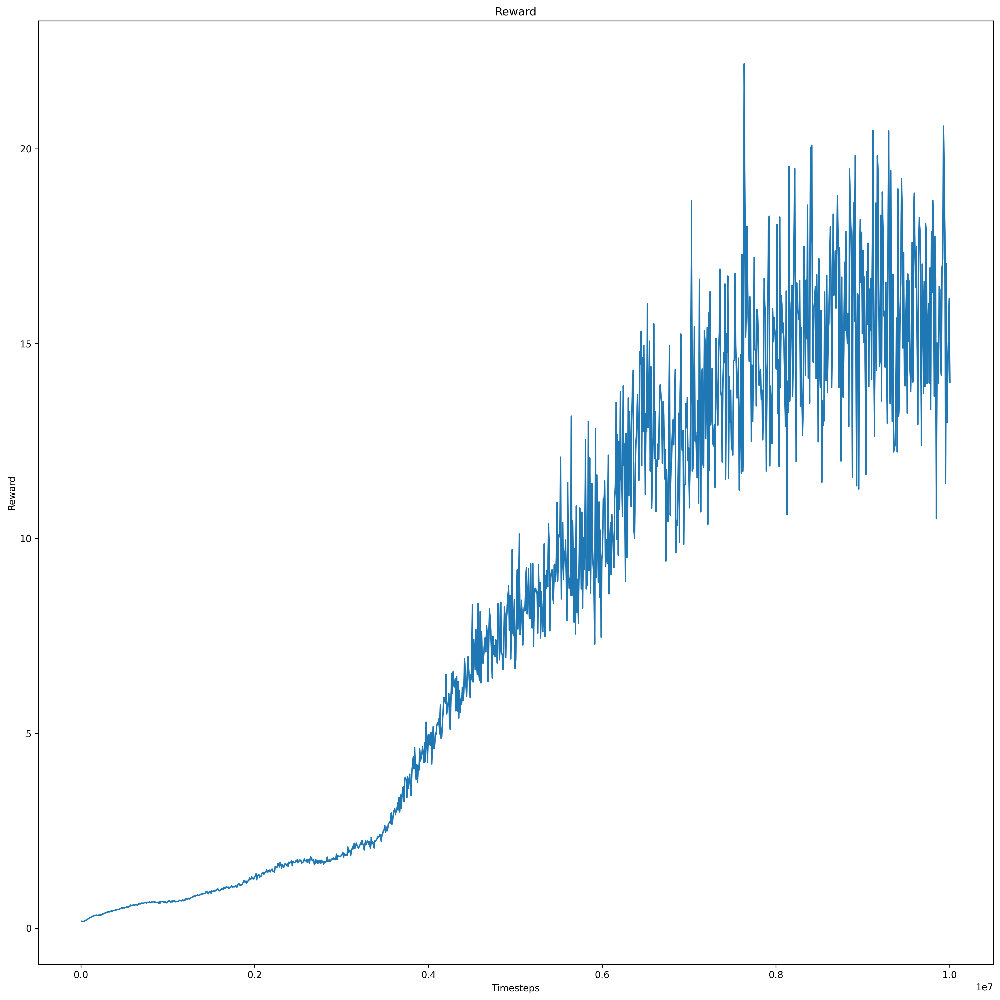

In [4]:
import sys
sys.modules.pop('package.train_log_analyzer', None)
from myosuite.rl_train.myoassist.analyzer.train_log_analyzer import TrainLogAnalyzer
train_log_analyzer = TrainLogAnalyzer(log_handler)
train_log_analyzer.plot_reward(result_dir=analyze_result_dir)


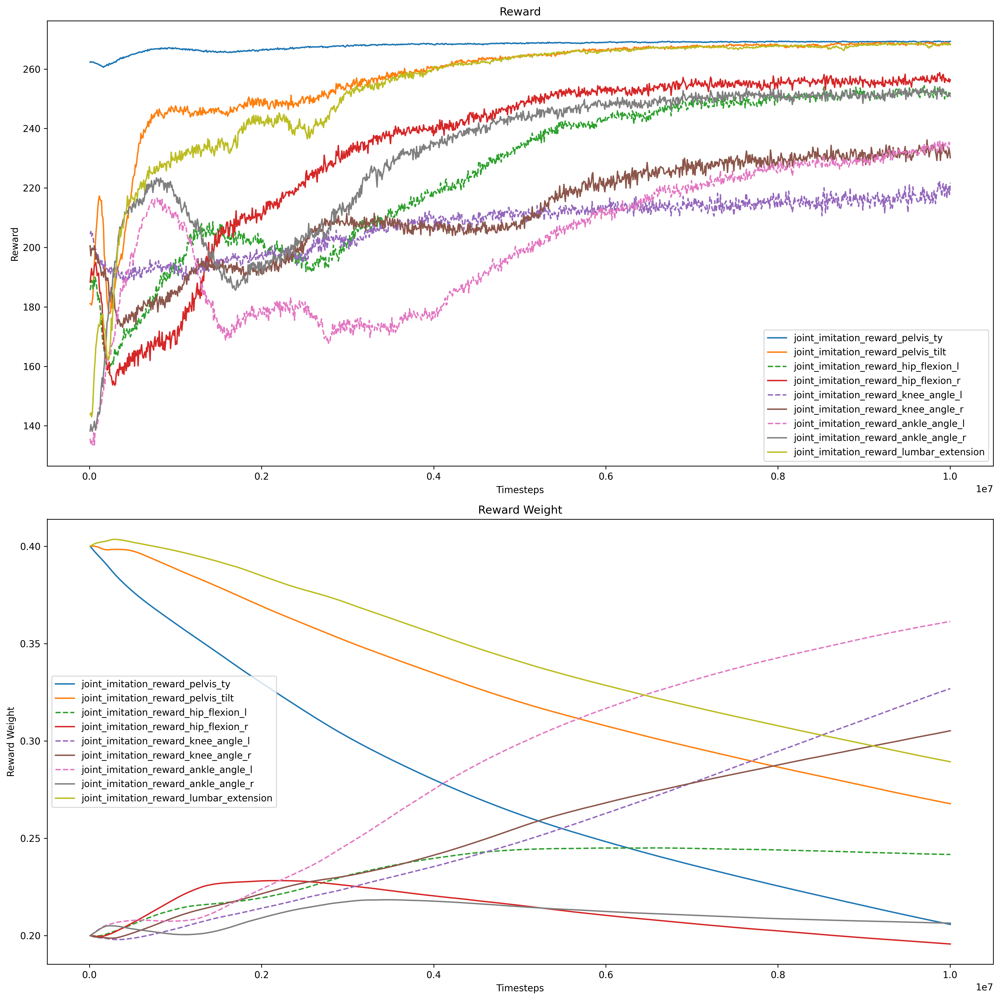

In [5]:
train_log_analyzer.plot_reward_weights(result_dir=analyze_result_dir)


## Load session config


In [6]:
import json
# from package.config import TrainSessionConfigBase
from myosuite.envs.myoassist.myo_leg_18_imitation import ImitationTrainSessionConfig
from myosuite.rl_train.myoassist.utils.data_types import DictionableDataclass
with open(os.path.join(log_dir, "session_config.json"), 'r') as f:
    config_dict = json.load(f)
config = DictionableDataclass.create(ImitationTrainSessionConfig, config_dict)


In [7]:
type(config.env_params)

myosuite.envs.myoassist.myo_leg_18_imitation.ImitationTrainSessionConfig.EnvParams

In [8]:
gait_data_name = f"{log_handler.session_name}_gait_evaluated_data.json"
if os.path.exists(os.path.join(analyze_result_dir, gait_data_name)):
    user_input = input(f"Regenerate evaluate data? ({gait_data_name}) (y/n(anything))")
else:
    user_input = "y"
is_regen_evaluating_data = True if user_input == "y" else False

from myosuite.rl_train.myoassist.analyzer.gait_evaluate import ImitationGaitEvaluator
gait_evaluator = ImitationGaitEvaluator(log_handler, config)
gait_evaluator.load_reference_data()
gait_evaluator.initialize_env()
if is_regen_evaluating_data:
    gait_data_path = gait_evaluator.evaluate(result_dir=analyze_result_dir,
                                            file_name=gait_data_name)
else:
    gait_data_path = os.path.join(analyze_result_dir, gait_data_name)
    

===============REFERENCE DATA LOADING================
===============REFERENCE DATA LOADING DONE================
Loading reference data from myosuite/simhive/myoassist_sim/reference_motions/neumove_02-constspeed_reduced_humanoid.npz
=================environment seed: 1234=====================
=================environment model_path: myosuite/simhive/myoassist_sim/gait14dof26musc_cvt3_Right_2D_DEPHY.xml=====================
    NeuMove MyoLeg18
    
===============================PARAMETERS=============================
self._reward_keys_and_weights=ImitationTrainSessionConfig.EnvParams.RewardWeights(forward_reward=0.2, muscle_activation_penalize=0.1, muscle_activation_diff_penalize=0.1, joint_imitation_reward_pelvis_ty=0.4, joint_imitation_reward_pelvis_tilt=0.4, joint_imitation_reward_hip_flexion_l=0.2, joint_imitation_reward_hip_flexion_r=0.2, joint_imitation_reward_knee_angle_l=0.2, joint_imitation_reward_knee_angle_r=0.2, joint_imitation_reward_ankle_angle_l=0.2, joint_imitation_rew

# Test gait_analyze.py - GaitAnalyzer

In [9]:
import sys
sys.modules.pop('package.gait_analyze', None)
sys.modules.pop('package.gait_evaluate', None)
from myosuite.rl_train.myoassist.analyzer.gait_analyze import GaitAnalyzer
from myosuite.rl_train.myoassist.analyzer.gait_evaluate import GaitData


gait_data = GaitData()
gait_data.read_json_data(gait_data_path)
import json 
with open(os.path.join("myosuite/simhive/myoassist_sim/reference_data_segmented/02-constspeed_reduced_humanoid_segmented.json"), 'r') as f:
    segmented_ref_data = json.load(f)
gait_analyzer = GaitAnalyzer(gait_data, segmented_ref_data, True)

self.gait_data.series_data.keys()=dict_keys(['joint_data', 'actuator_data', 'sensor_data', 'physics_data'])


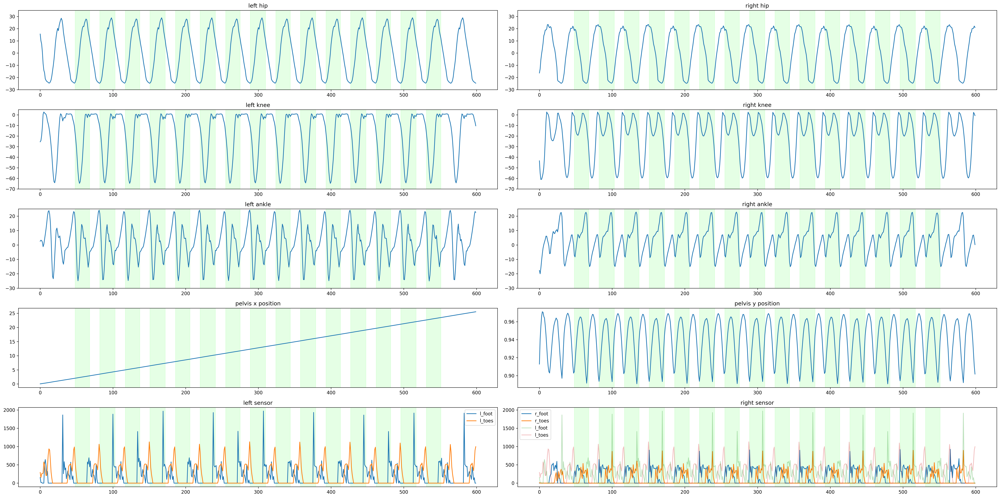

In [10]:
gait_analyzer.plot_entire_result(result_dir=analyze_result_dir,is_right_foot_based=True)

self.gait_data.series_data.keys()=dict_keys(['joint_data', 'actuator_data', 'sensor_data', 'physics_data'])


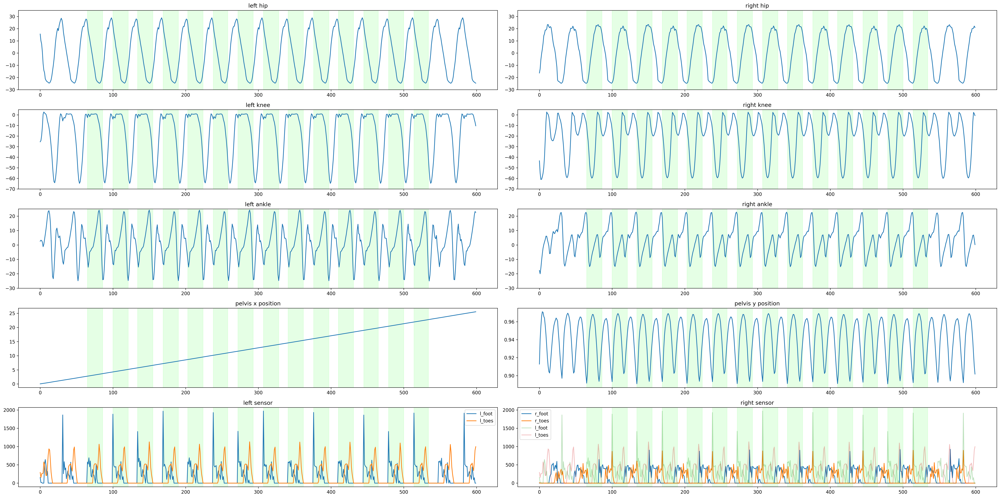

In [11]:
gait_analyzer.plot_entire_result(result_dir=analyze_result_dir,is_right_foot_based=False)

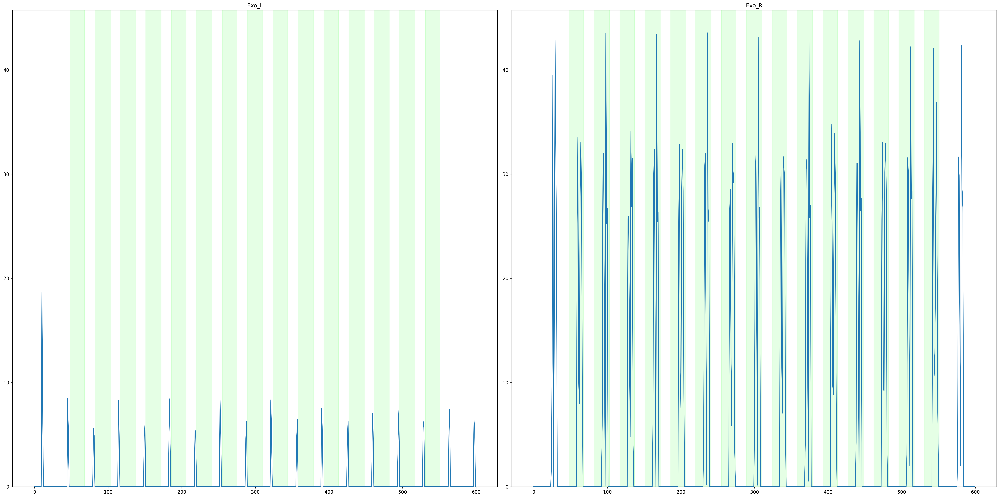

In [12]:
gait_analyzer.gait_data.series_data["actuator_data"].keys()
gait_analyzer.plot_exo_data(result_dir=analyze_result_dir)

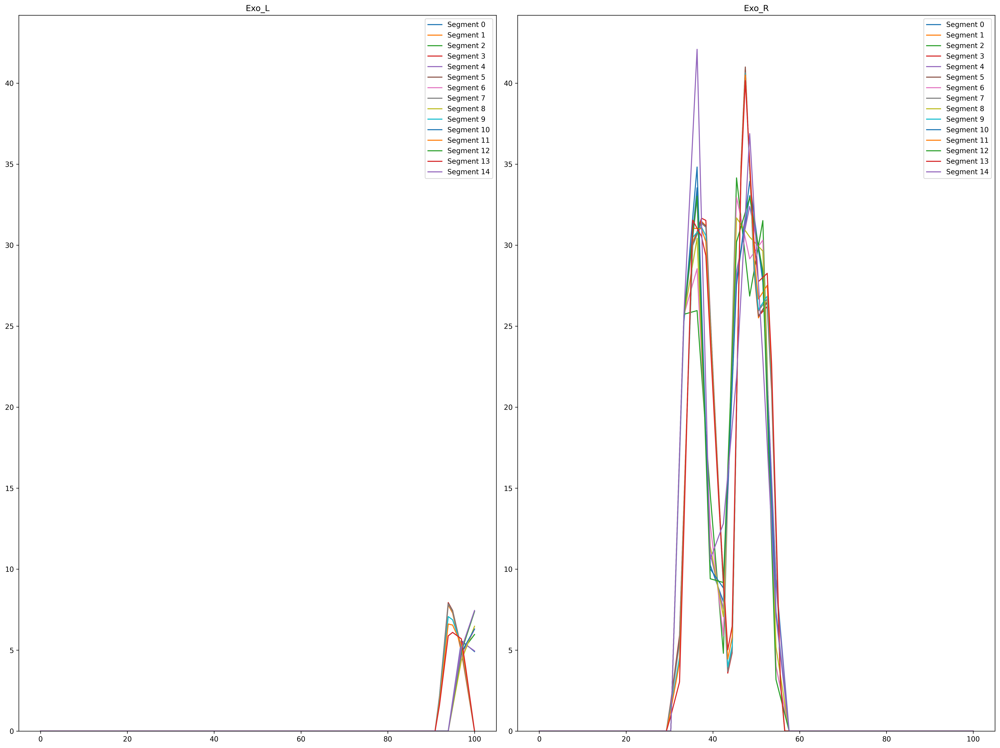

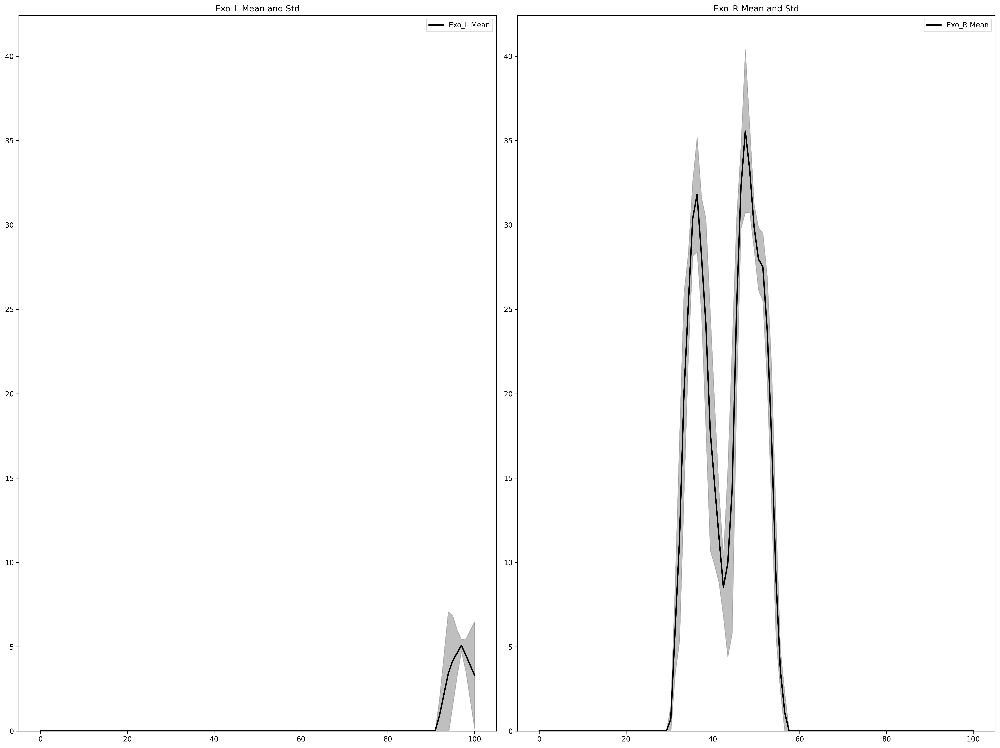

In [13]:
gait_analyzer.plot_exo_segmented_data(result_dir=analyze_result_dir)

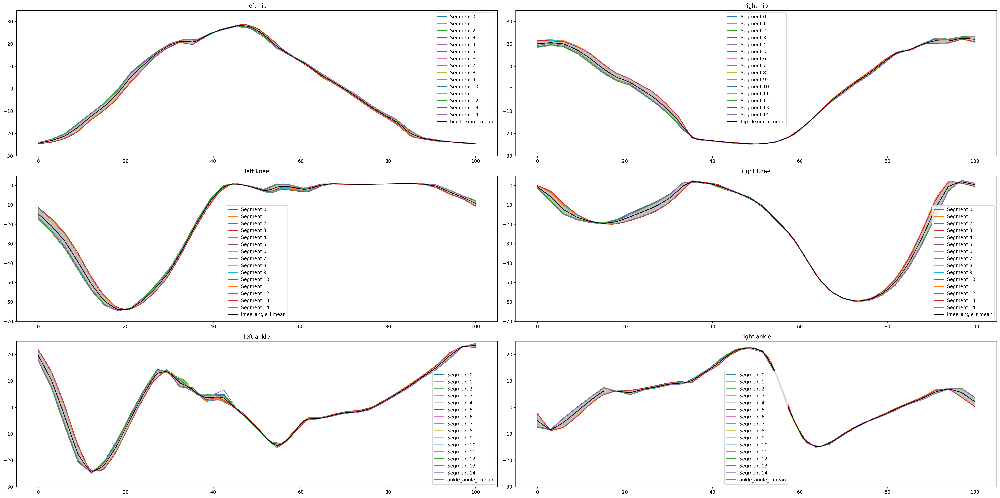

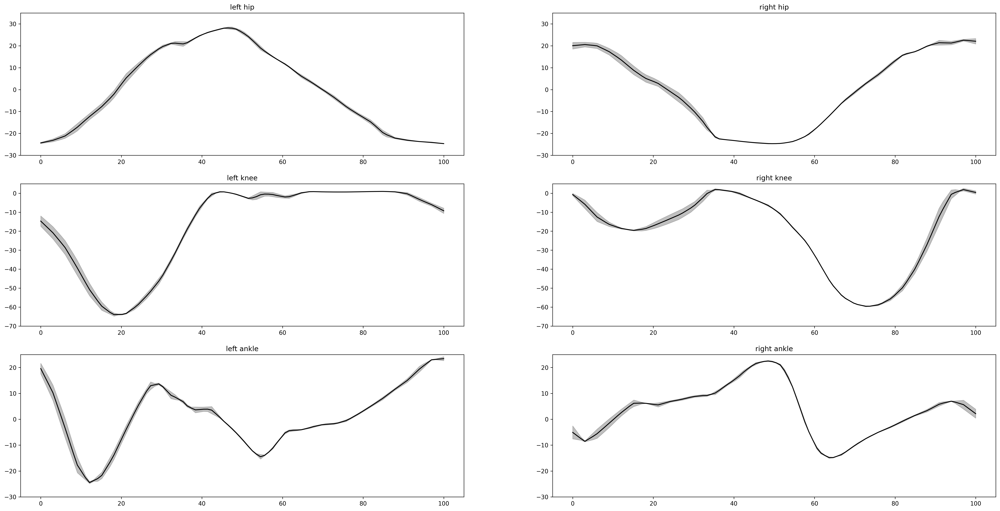

In [15]:
gait_analyzer.plot_segmented_kinematics_result(result_dir=analyze_result_dir)

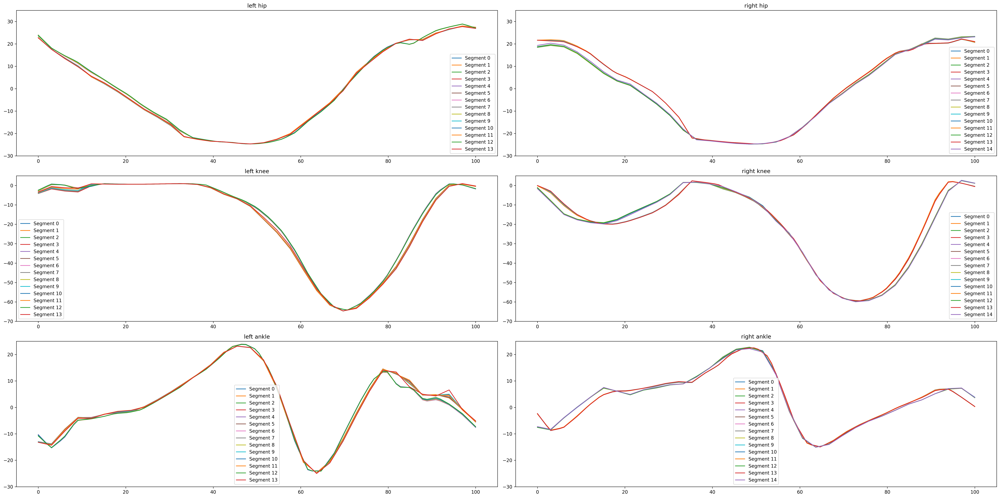

DEBUG:: joint='hip_flexion_l', data.shape=(14, 100)
DEBUG:: joint='hip_flexion_r', data.shape=(15, 100)
DEBUG:: joint='knee_angle_l', data.shape=(14, 100)
DEBUG:: joint='knee_angle_r', data.shape=(15, 100)
DEBUG:: joint='ankle_angle_l', data.shape=(14, 100)
DEBUG:: joint='ankle_angle_r', data.shape=(15, 100)


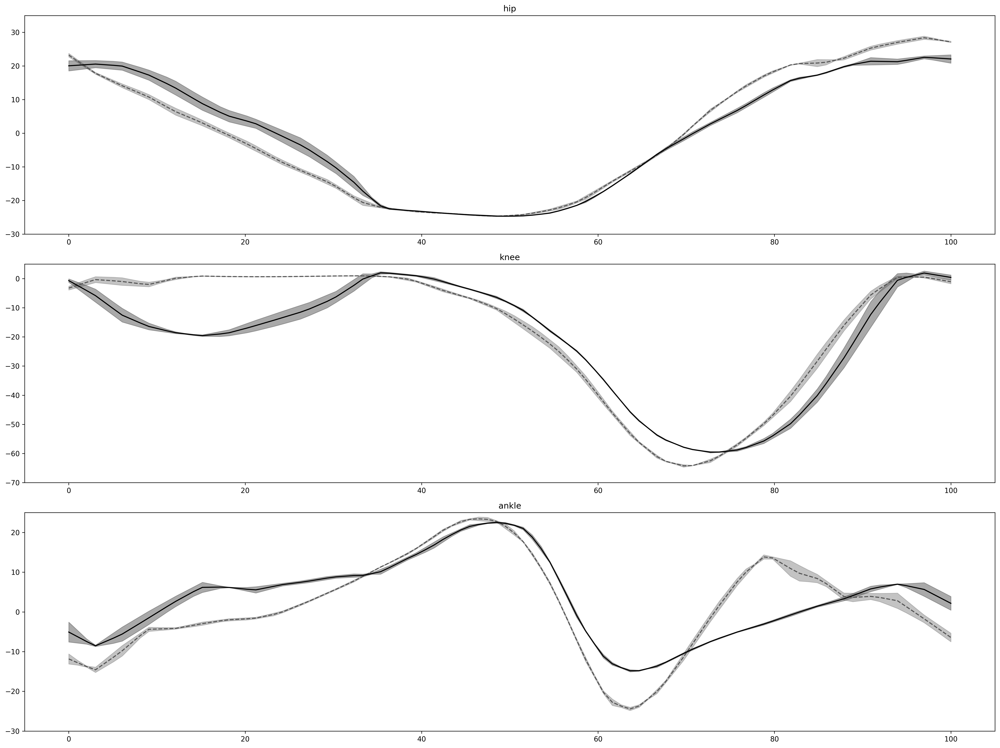

In [16]:
gait_analyzer.plot_left_right_comparison(result_dir=analyze_result_dir)

## compare with reference data

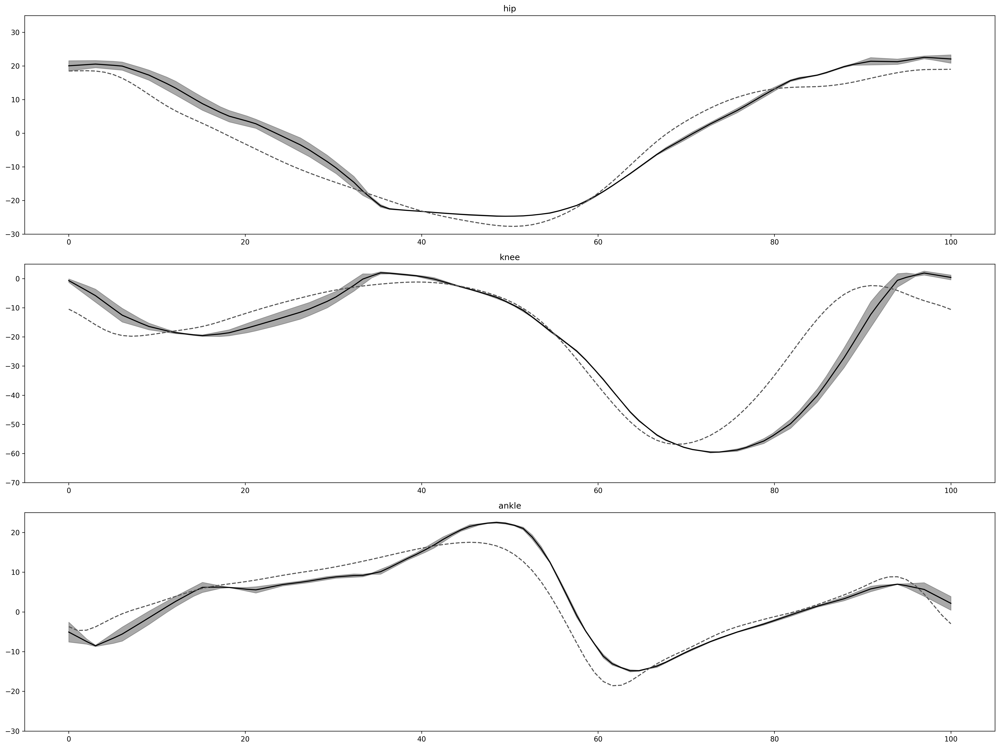

In [17]:
## compare with reference data
gait_analyzer.plot_right_ref_comparison(result_dir=analyze_result_dir)


# Contact data

In [18]:
# Contact data
print(len(gait_data.series_data["physics_data"]["contacts"]["data"]))
contact_data_num = 0
contact_object_name_set = set()
for contact_data_list in gait_data.series_data["physics_data"]["contacts"]["data"]:
    contact_data_num += len(contact_data_list)
    for contact_data in contact_data_list:
        contact_object_name_set.add(contact_data["geom1"])
        contact_object_name_set.add(contact_data["geom2"])

print(f"average contact data per frame: {contact_data_num/len(gait_data.series_data['physics_data']['contacts']['data'])}")
print(contact_object_name_set)


600
average contact data per frame: 4.006666666666667
{'tb_mid_r_geom', 'tb_toe_l_geom', 'ground-plane', 'tb_mid_l_geom', 'tb_toe_r_geom', 'toes_r_geom_1'}


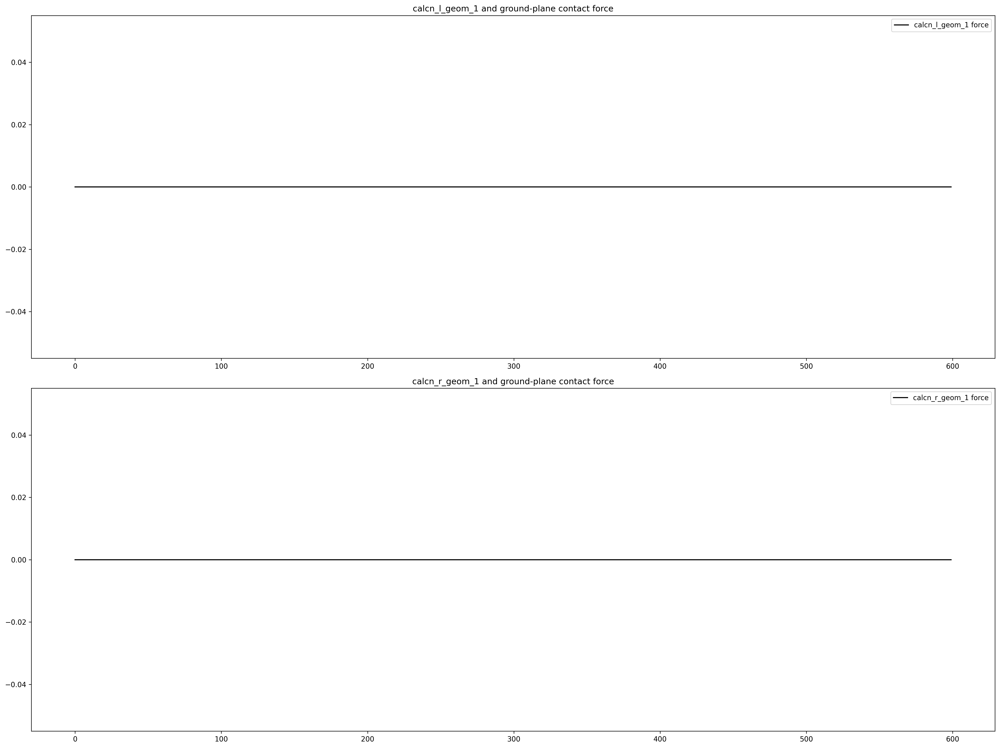

In [19]:
gait_analyzer.plot_contact_data(result_dir=analyze_result_dir)

# Muscle plot

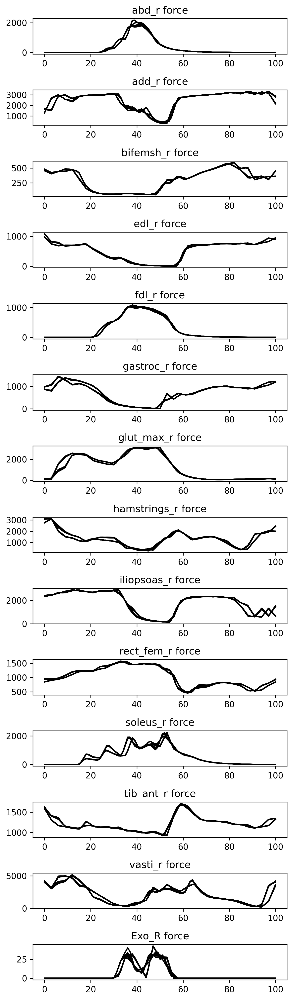

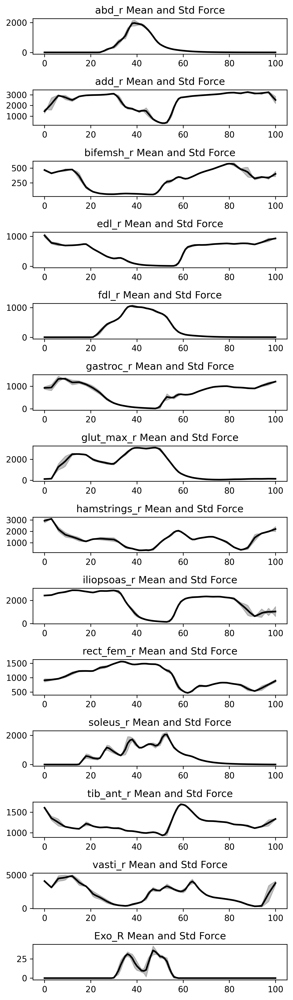

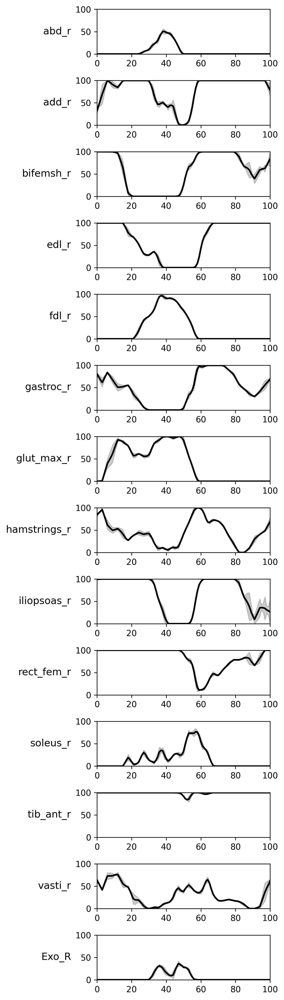

In [20]:
gait_analyzer.plot_segmented_muscle_data(result_dir=analyze_result_dir)

# Test gait_evaluate.py - GaitEvaluater replay


In [21]:
gait_evaluator.replay(gait_data_path, os.path.join(analyze_result_dir, "replay.mp4"))